# Library

In [1]:
import numpy as np
import math
import os
import sys
import scipy
from scipy.signal import argrelextrema, correlate2d
from scipy.misc import imresize
from scipy import ndimage
import matplotlib.pyplot as plt
import tensorflow as tf
%matplotlib inline

# Some Functions

In [2]:
class Vars() :
    def __init__(self) :
        self.handler = {}
        
    def get(self, key) :
        return self.handler[key]
    
    def put(self, key, value) :
        self.handler[key] = value

In [3]:
def autocorr(x):
    result = np.correlate(x, x, mode='full')
    return result[result.size/2:]

In [4]:
def autocorr2d(x):
    result = correlate2d(x, x, mode='full')
    return result[result.shape[0]/2:, result.shape[1]/2:]

In [5]:
def rgb2gray(img):
    return np.dot(img[...,:3], [0.299, 0.587, 0.114])

# Data Loading

In [6]:
# Prepare variables
V = Vars()
V.put('data_dir', os.getcwd() + "/../full_data/")
V.put('data_dir_cell', os.getcwd() + "/../full_data_cell/")
V.put('cell_x', 140)
V.put('cell_y', 280)

In [23]:
# Loading Image & Error
import glob
data_dir = V.get('data_dir')
cats = os.listdir(data_dir)
for c in cats :
    if not filter(os.path.isdir, glob.glob(data_dir + c)) :
         cats.remove(c)
cats.remove("shchoi")
cats.remove("others")
# cats.remove("file_list.txt")
cats.remove("Template3.bmp")
print cats

anns = {}
cnt = 0
for c in cats :
    for name in os.listdir(data_dir + c):
        if name.split('.')[-1] == "jpg" and np.random.random() < 0.02 :
            img = ndimage.imread(data_dir + c + "/" + name).astype(float)
            anns[name] = {'img':img, 'cat':c, 'name':name}
            
# f = open(data_dir + "file_list.txt", 'r')
f = open(data_dir + "error_xy.txt", 'r')
errLines = f.readlines()
for i, l in enumerate(errLines) :
    tokens = l.split(':')[-2:]
    c, name = tokens[0].split('\\')[-2:]
    if name in anns :
        err = tokens[1][:-3].replace(')','').replace('(','').replace(']','').replace('[',',').split(',')
        if len(err) > 1 :
            anns[name]['err'] = map(int, err)
print "Loading done"

['CORROSION', 'PASS', 'PAST_REPAIR', 'GAT2_HABU_PTN_E', 'GAT1_HABU_PTN_E', 'SHORT_P', 'PI_UNDER_S', 'SD_BOMB', 'SD_SPOT', 'CNT_NOT_OPEN', 'PI_UNDERLAYER', 'ACT_HABU_PTN_ER', 'CNT_FILM', 'ILD_FLAKE', 'PI_UNDER_K', 'LARVA', 'PTN_ERR', 'TI_YUSIL', 'HOLE_PTN_ERR', 'CNT_NOT_OPEN_S', 'SHORT_D', 'BLACK_SPOT', 'BLACK_IMUL']
Loading done


In [24]:
print len(anns)

757


Total # of images :  757
Category : TI_YUSIL Name : A2MR1S71LKDA4.A2MR1S71LKDCB132.012_20170130180333.jpg
Category : CNT_NOT_OPEN_S Name : A2MR1S71NP8A9.A2MR1S71NP8AB034.012_20170201022503.jpg
Category : CNT_NOT_OPEN_S Name : A2MR1S71QLCA9.A2MR1S71QLCBD026.056_20170131154925.jpg
Category : CNT_NOT_OPEN_S Name : A2MR1S71QLCA9.A2MR1S71QLCBD026.056_20170131154925.jpg
Category : CNT_NOT_OPEN_S Name : A2MR1S71PC8A8.A2MR1S71PC8DA125.031_20170131094216.jpg
Category : SD_BOMB Name : A2MR1S71OVKA5.A2MR1S71OVKBD011.054_20170131085735.jpg


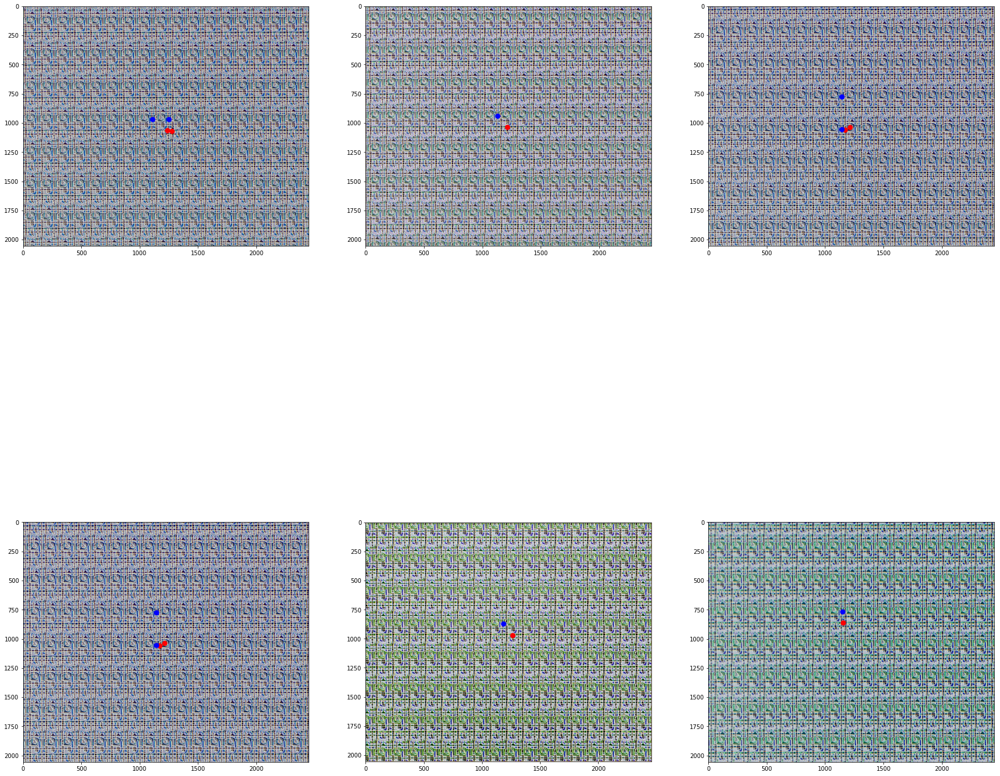

In [60]:
# Visulize
from matplotlib.patches import Circle
print "Total # of images : ", len(anns)
fig, ax = plt.subplots(2, 3, figsize=(30, 20))
idxs = np.random.permutation(len(anns))[:6]
idxs[5] = 30
for i in range(2):
    for j in range(3):
        n = 3*i + j
        a = anns.values()[idxs[n]]
        ax[i,j].imshow(a['img'])
        print "Category :", a['cat'], "Name :", a['name']
        e = a['err']
        for x,y,x_st,y_st in zip(e[0::4], e[1::4], e[2::4], e[3::4]) :
            circ_r = Circle((x,y), 20, color='r')
            circ_b = Circle((x_st,y_st), 20, color='b')
            ax[i,j].add_patch(circ_r)
            ax[i,j].add_patch(circ_b)
# plt.imshow(image)

In [24]:
print a['img'].shape

(2058, 2456, 3)


# RGB to other information

In [19]:
# rgb to gray
for a in anns.values() :
    a['img_gray'] = rgb2gray(a['img'])

Category : BLACK_SPOT
Category : BLACK_SPOT
Category : GAT1_HABU_PTN_E


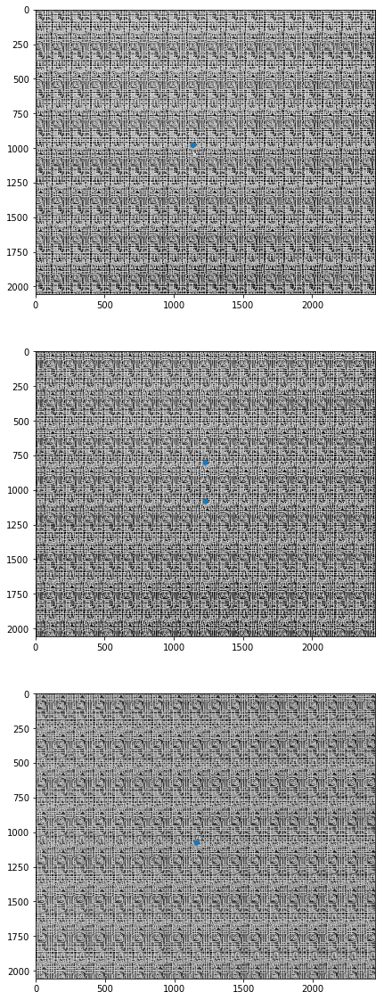

In [11]:
# visualize
# fig, ax = plt.subplots(3, 2, figsize=(10, 10))
# idxs = np.random.permutation(len(grayImgs))[:6]
# for i in range(3):
#     for j in range(2):
#         ax[i,j].imshow(grayImgs[idxs[i*2+j]], vmin=0, vmax=255, cmap='gray_r')
from matplotlib.patches import Circle
fig, ax = plt.subplots(3, 1, figsize=(20, 20))
idxs = np.random.permutation(len(anns))[:3]
for i in range(3):
#     n = 2*i + j
    a = anns.values()[idxs[i]]
    ax[i].imshow(a['img_gray'], vmin=0, vmax=255, cmap='gray_r')
    print "Category :", a['cat']
    e = a['err']
    for x,y in zip(e[0::2], e[1::2]) :
        circ = Circle((x,y), 20)
        ax[i].add_patch(circ)

In [141]:
# rgb channel mean subtraction
for a in anns.values() :
    img = a['img']
    a['img_zeroCh'] = img - np.tile(np.average(img, axis=(0,1)), (img.shape[0], img.shape[1], 1))
    print np.average(a['img_zeroCh'], axis=(0,1))

[ -8.29425781e-13  -2.25381493e-10  -3.41591548e-10]
[  1.02654837e-10   1.38426587e-10  -4.73846836e-10]
[ -1.63627860e-11   4.19376656e-11  -1.23454278e-11]
[ -1.32525392e-11  -4.38997669e-11  -2.03026702e-11]
[  1.56379105e-11  -3.80469710e-12  -2.00636149e-11]
[ -3.23357991e-12   2.29820862e-11   3.33243212e-12]
[ -5.78664361e-12  -4.93155824e-12  -2.42547040e-11]
[ -1.41299410e-10   1.75975664e-11  -4.72228664e-10]
[  1.55454251e-11   4.66990187e-11  -1.26475996e-11]
[ -4.46760729e-12   8.90390251e-11  -4.75746538e-12]
[ -7.52744234e-12  -4.83038801e-11   9.42623682e-12]
[  3.03197437e-10  -1.73094117e-10   5.07652904e-10]
[ -3.63582894e-10  -2.67829171e-10   1.54222284e-10]
[  4.68807212e-12   1.42353368e-11  -4.01495963e-11]
[  4.75776835e-11  -4.68302415e-11   5.74391451e-10]
[ -1.44743494e-10  -1.13153640e-10  -2.15128608e-10]
[ -2.54228889e-11  -1.67075508e-12  -3.05734706e-12]
[ -2.05027693e-11   4.84385115e-11   9.66036771e-12]
[ -1.89519458e-11   1.02940597e-11  -1.5104505

# Calculate Autocorrelation

In [20]:
# test = autocorr2d(gray)
# print test.shape
# prepare
# horInter = 137
# verInter = 277
tempX = 138
tempY = 270
resizeX = 140
resizeY = 280

X = tf.placeholder(tf.float32, name="Image")
t = tf.placeholder(tf.float32, name="Template")
conv = tf.nn.conv2d(X, t, strides=[1,1,1,1], padding='VALID')

# init = tf.initialize_all_variables()
init = tf.global_variables_initializer()
sess = tf.Session(config=tf.ConfigProto(gpu_options=tf.GPUOptions(allow_growth=True)))
sess.run(init)

In [21]:
# calculate correlation
corr = []
# for img in grayImgs:
# #     height = img.shape[1]
# #     width = img.shape[2]
#     img = img.reshape(-1, img.shape[0], img.shape[1], 1)
#     template = img[:, :tempY, :tempX, :].reshape(tempY,tempX,1,1)
#     corr_o = sess.run(conv, feed_dict={X:img, t:template})
#     corr.append(corr_o.reshape(corr_o.shape[1], corr_o.shape[2]))
#     plt.imshow(template, cmap='gray_r')
#     corr = correlate2d(gray[:7*tempY, :13*tempX], template, boundary='symm', mode='full')
#     corr = corr[tempY-1:-tempY+1, tempX-1:-tempX+1]

for a in anns.values() :
    img = a['img_gray']
    img = img.reshape(-1, img.shape[0], img.shape[1], 1)
    template = img[:, :tempY, :tempX, :].reshape(tempY,tempX,1,1)
    corr_o = sess.run(conv, feed_dict={X:img, t:template})
    a['corr'] = corr_o.reshape(corr_o.shape[1], corr_o.shape[2])

In [14]:
# print len(corr)
a = anns.values()[1]
print a['corr'][0,0]/np.max(a['corr'])

0.88263


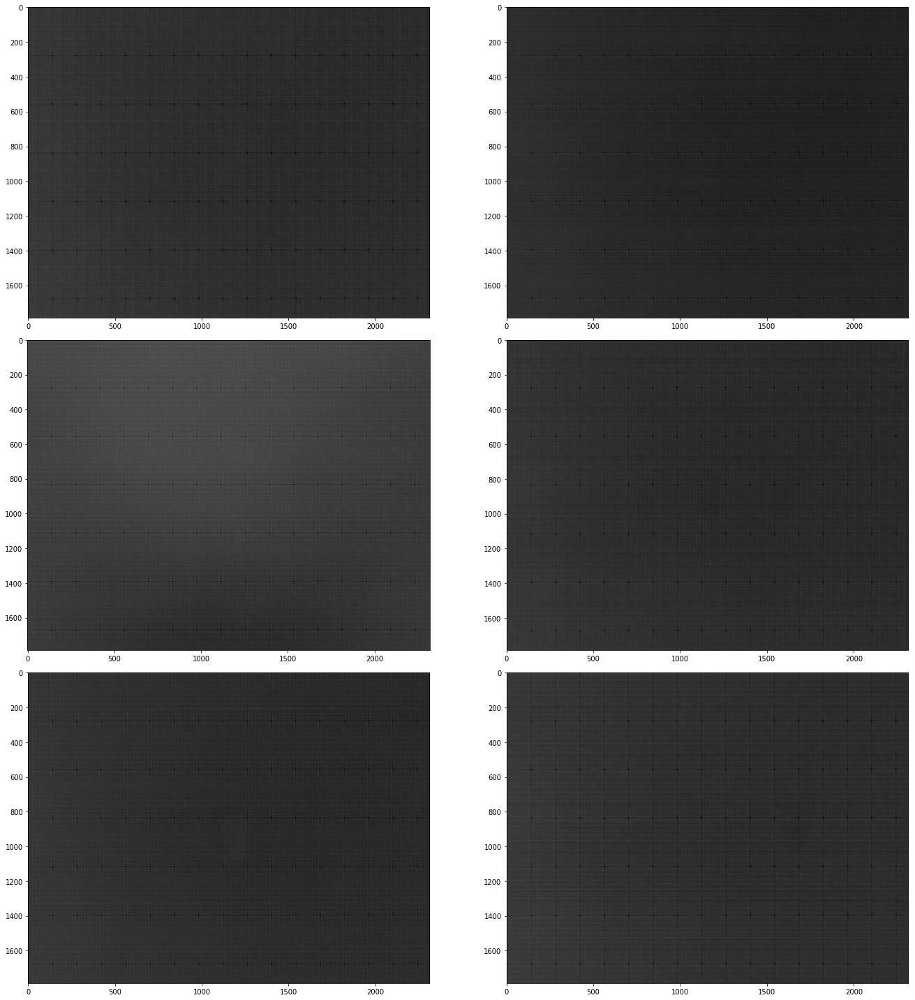

In [11]:
idxs = np.random.permutation(len(anns))[:6]
fig, ax = plt.subplots(3, 2, figsize=(20, 20))
for i in range(3):
    for j in range(2):
        n = 2*i + j
        a = anns.values()[idxs[n]]
#         ax[i,j].imshow(corr[idxs[i*vWid+j]]/np.max(corr[idxs[i*vWid+j]]), cmap='gray_r')
        corr = a['corr']
        ax[i,j].imshow(corr/np.max(corr), cmap='gray_r', vmax=1, vmin=0)
plt.tight_layout()

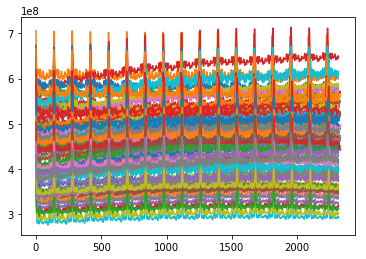

In [22]:
# infer slice index
# idxsSlc = []
for a in anns.values() :
    horCorr = a['corr'][0,:]
    verCorr = a['corr'][:,0]
    plt.plot(horCorr)
    horIdx = []
    verIdx = []
    for i in range(horCorr.size/tempX):
        horIdx.append(i*tempX + np.argmax(horCorr[i*tempX:(i+1)*tempX]))
    horIdx.append((i+1)*tempX + np.argmax(horCorr[(i+1)*tempX:]))
#     print "horizon cut :", horIdx
    for i in range(verCorr.size/tempY):
        verIdx.append(i*tempY + np.argmax(verCorr[i*tempY:(i+1)*tempY]))
    verIdx.append((i+1)*tempY + np.argmax(verCorr[(i+1)*tempY:]))
#     print "vertical cut :", verIdx
    a['slcX'] = horIdx
    a['slcY'] = verIdx
    
    # horIdx.append(horCorr.size)
    # verIdx.append(verCorr.size)
#     print horIdx, verIdx
# print idxsSlc

# Template?

In [86]:
idx = np.random.randint(len(anns))
a = anns.values()[idx]
tmp = a['img_gray'][:280,:140].reshape(280, 140, 1, 1)

In [99]:
# calculate correlation
for a in anns.values() :
    img = a['img_gray'][:560-1,:280-1]
    img = img.reshape(-1, img.shape[0], img.shape[1], 1)
#     template = img[:, :tempY, :tempX, :].reshape(tempY,tempX,1,1)
    corr_o = sess.run(conv, feed_dict={X:img, t:tmp})
    a['corr_tmp'] = corr_o.reshape(corr_o.shape[1], corr_o.shape[2])

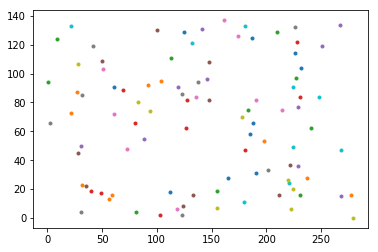

In [108]:
for a in anns.values() :
    a['offset'] = np.unravel_index(np.argmax(a['corr_tmp']), a['corr_tmp'].shape)
    plt.plot(a['offset'][0], a['offset'][1], '.')
#     print a['corr_tmp'].shape
#     horCorr = a['corr_tmp'][0,:]
#     verCorr = a['corr_tmp'][:,0]
#     plt.plot(horCorr)
#     horIdx = []
#     verIdx = []
#     for i in range(horCorr.size/tempX):
#         horIdx.append(i*tempX + np.argmax(horCorr[i*tempX:(i+1)*tempX]))
#     horIdx.append((i+1)*tempX + np.argmax(horCorr[(i+1)*tempX:]))
#     print "horizon cut :", horIdx-horIdx[0]
#     for i in range(verCorr.size/tempY):
#         verIdx.append(i*tempY + np.argmax(verCorr[i*tempY:(i+1)*tempY]))
#     verIdx.append((i+1)*tempY + np.argmax(verCorr[(i+1)*tempY:]))
#     print "vertical cut :", verIdx-verIdx[0]
#     a['slcX'] = horIdx
#     a['slcY'] = verIdx

# plt.plot(horCorr[horIdx[0]:])

# Image Slicing

In [124]:
# slice from 0, 0
# fig, ax = plt.subplots(len(verIdx)-1, len(horIdx)-1, figsize=(7,10))
slcNumX = len(anns.values()[0]['slcX'])-1
slcNumY = len(anns.values()[0]['slcY'])-1
# imgSlcs = []
# for i in range(len(verIdx)-1):
#     for j in range(len(horIdx)-1):
#         print verIdx[i], verIdx[i+1], horIdx[j], horIdx[j+1]
for a in anns.values() :
    img = a['img_gray']
    slc = [ [x for x in range(slcNumX)] for y in range(slcNumY) ]
    horIdx = a['slcX']
    verIdx = a['slcY']
    for j in range(slcNumY):
        for k in range(slcNumX):
            currSlc = imresize(img[verIdx[j]:verIdx[j+1], horIdx[k]:horIdx[k+1]], (resizeY, resizeX), mode='F')
            slc[j][k] = currSlc
#             plt.imshow(currSlc)
#             print currSlc.shape
    a['slc'] = slc
#     ax[i,j].imshow(currImg, cmap='gray_r', vmin=0, vmax=255)
#     ax[i,j].axis('off')
#             slc[currSlc] = 
    
#     imgSlcs.append(slc)

In [230]:
print type(a['img_gray'])

<type 'numpy.ndarray'>


In [134]:
# slice from offset
slcNumX = anns.values()[0]['img'].shape[1]/140 - 1
slcNumY = anns.values()[0]['img'].shape[0]/280 - 1
for a in anns.values() :
    img = a['img']
    offset_y, offset_x = a['offset']
    slc = [ [x for x in range(slcNumX)] for y in range(slcNumY) ]
    for j in range(slcNumY) :
        for k in range(slcNumX) :
            slc[j][k] = img[offset_y+280*j:offset_y+280*(j+1), offset_x+140*k:offset_x+140*(k+1), :]
    a['slc_offset'] = slc

96


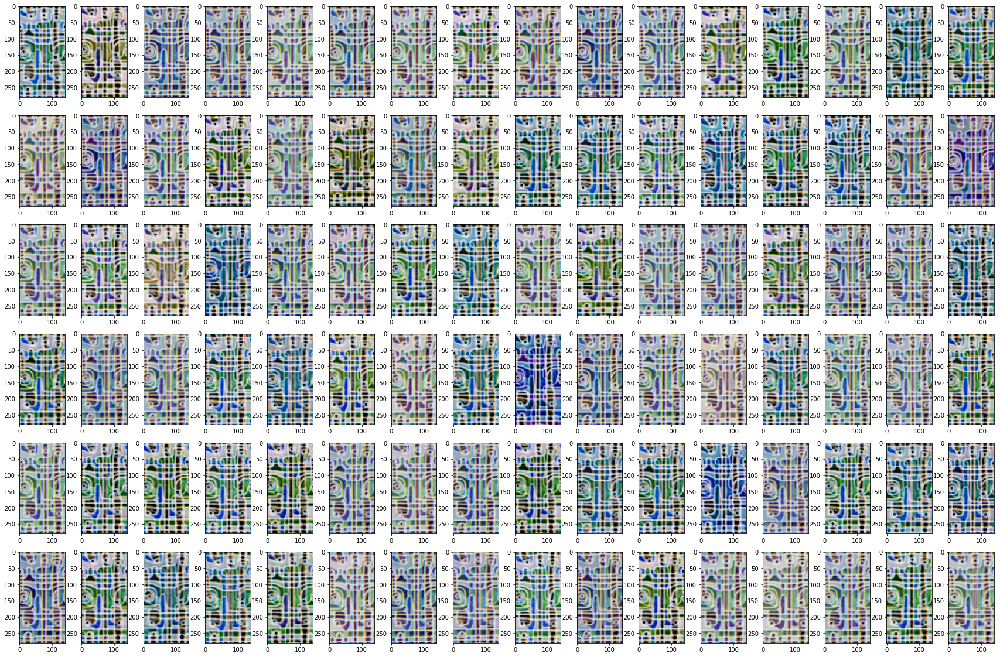

In [149]:
fig, ax = plt.subplots(6, 16, figsize=(30, 20))
for i in range(6) :
    for j in range(16) :
        n = i*16 + j
        a = anns.values()[n]
        id_x = np.random.randint(slcNumX)
        id_y = np.random.randint(slcNumY)
        ax[i,j].imshow(a['slc_offset'][id_y][id_x])
#         print a['slc_offset'][id_y][id_x].shape
print len(anns)

In [125]:
print slcNumX, slcNumY

16 6


In [15]:
# Find Error Slices
# errSlcs = []
for a in anns.values() :
    slc = []
    if 'err' in a.keys() :
        e = a['err']#.replace(')','').replace('(','').split(',')
    else :
        e = []
    a['is_err'] = np.zeros((slcNumY, slcNumX))
    if len(e) > 0 :
        for j in range(len(e)/2) :
            offsetX = int(e[2*j])/tempX
            offsetY = int(e[2*j+1])/tempY
#             print int(e[2*j]), offsetX, (int(e[2*j+1])), offsetY
    #         slcOff = vWid*(int(e[2*j])/tempY) + (int(e[2*j])/tempX)
#             if slcOff < vHgh*vWid :
#                 slc.append(slcOff)
            if offsetX < slcNumX and offsetY < slcNumY :
                a['is_err'][offsetY, offsetX] = 1
#     print a['is_err']
#         errSlcs.append(list(set(slc)))

[[ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]]


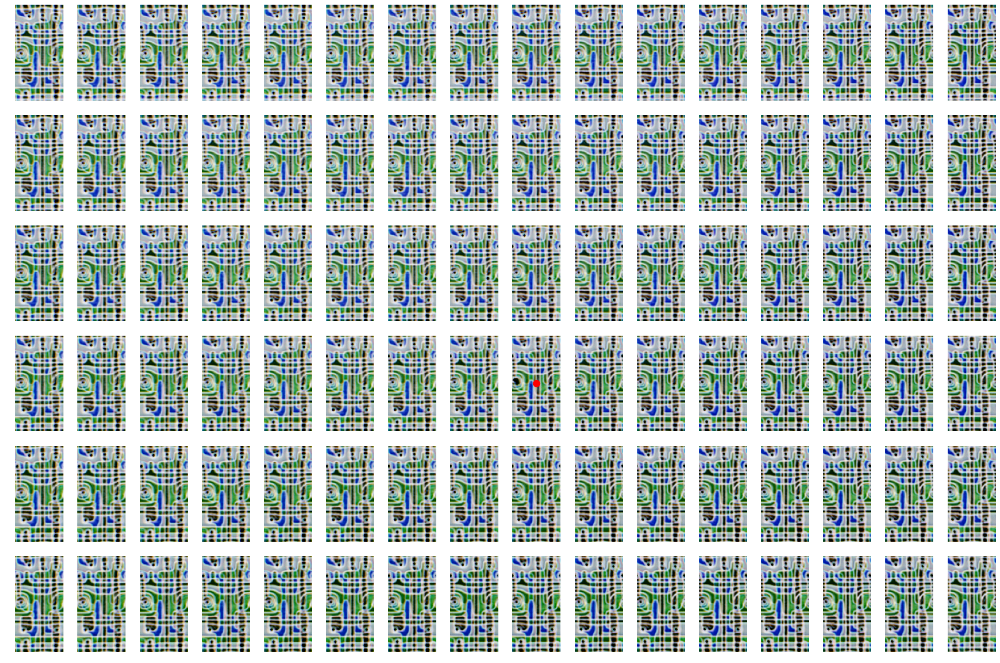

In [150]:
# visualize slices with errors
idx = np.random.randint(len(anns))
# idx = 5
# horIdx, verIdx = idxsSlc[idx]
# vWid = len(horIdx)-1
# vHgh = len(verIdx)-1
fig, ax = plt.subplots(slcNumY, slcNumX, figsize=(30,20))
a = anns.values()[idx]
print a['is_err_offset']
for i in range(slcNumY):
    for j in range(slcNumX):
        if a['is_err_offset'][i,j] == 0:
            ax[i,j].imshow(a['slc_offset'][i][j], vmin=0, vmax=255)
        else :
            ax[i,j].imshow(a['slc_offset'][i][j], vmin=0, vmax=255)
            circ = Circle((70,140), 10, color='r')
            ax[i,j].add_patch(circ)
        ax[i,j].axis('off')
plt.tight_layout()

In [53]:
print a['cat']

CNT_FILM


# Compare

In [306]:
# # subtract by first slice
# compSlcs = []
# for i in range(len(corr)):
#     slc = []
#     horIdx = idxsSlc[i][0]
#     verIdx = idxsSlc[i][1]
#     currImg = imgSlcs[i]
#     baseSlc = currImg[0]
#     # baseImg = imageCrop[0].astype(int)
#     for j in range(len(verIdx)-1):
#         for k in range(len(horIdx)-1):
#             currSlc = currImg[j*(len(horIdx)-1) + k]
#             slc.append(abs(currSlc - baseSlc))
#     compSlcs.append(slc)

In [216]:
# subtract by average slice
# compSlcs = []
for a in anns.values()[:3] :
    slcCompAvg = [ [x for x in range(slcNumX)] for y in range(slcNumY) ]
#     slc = a['slc']
    slc = a['slc_offset']
#     is_err = a['is_err']
    is_err = a['is_err_offset']
#     currImg = imgSlcs[i]
    baseSlc = np.zeros((280,140,3), dtype=np.float32)
    cnt = 0
    for i in range(slcNumY) :
        for j in range(slcNumX) :
            if is_err[i][j] == 0 :
                baseSlc += slc[i][j]
#                 plt.figure(i*slcNumX + j)
#                 print np.average(baseSlc), cnt
                cnt += 1
#                 plt.imshow(baseSlc/cnt)
#                 print cnt, np.min(baseSlc), np.min(baseSlc/cnt)
    baseSlc = baseSlc/cnt
#     plt.imshow(baseSlc)
    # baseImg = imageCrop[0].astype(int)
    for i in range(slcNumY):
        for j in range(slcNumX):
#             if is_err[i][j] == 0 :
            slcCompAvg[i][j] = abs(slc[i][j] - baseSlc)
            print np.average(slcCompAvg[i][j])
#             print np.average(slcCompAvg[i][j])
#             else :
#                 slcCompAvg[i][j] = np.zeros((resizeY, resizeX))
    a['slcCompAvg_offset'] = slcCompAvg

44.3724433949
43.034364344
41.5689368861
40.6084180005
39.2974785215
38.2776250892
37.655160843
37.3924377426
37.1207900084
37.6294458295
38.3367989011
39.4859431573
40.656045749
42.2618811838
43.6810894572
45.0756609934
40.9944454526
39.214357489
37.4988010149
35.8970038726
34.1477338963
32.6008689069
31.7468691089
31.212312834
31.0628562371
31.6444491157
32.6117027853
34.4109586066
36.6472865954
38.9262753345
40.9849025405
42.681855299
38.7614528927
36.8513426233
34.7140890302
32.7757636589
30.783199378
29.3592625808
28.2724690922
27.7332111834
27.3409181963
28.0777671028
29.6373429254
31.8801131957
34.5485203186
37.1304553374
39.5932034017
41.8694562408
37.9827315026
36.320629418
34.2981584041
32.5331776085
30.7520592841
29.3472524906
28.6646810761
28.1950404124
28.3683619513
29.2753693959
30.9117601116
33.2097843949
35.9235927254
38.439456605
40.9722190209
43.3240918702
39.5775217529
38.3481582281
36.9197891411
35.723584121
34.5656292363
33.6737893085
33.5728924326
34.931169266
35.

In [188]:
baseSlc.dtype

dtype('float64')

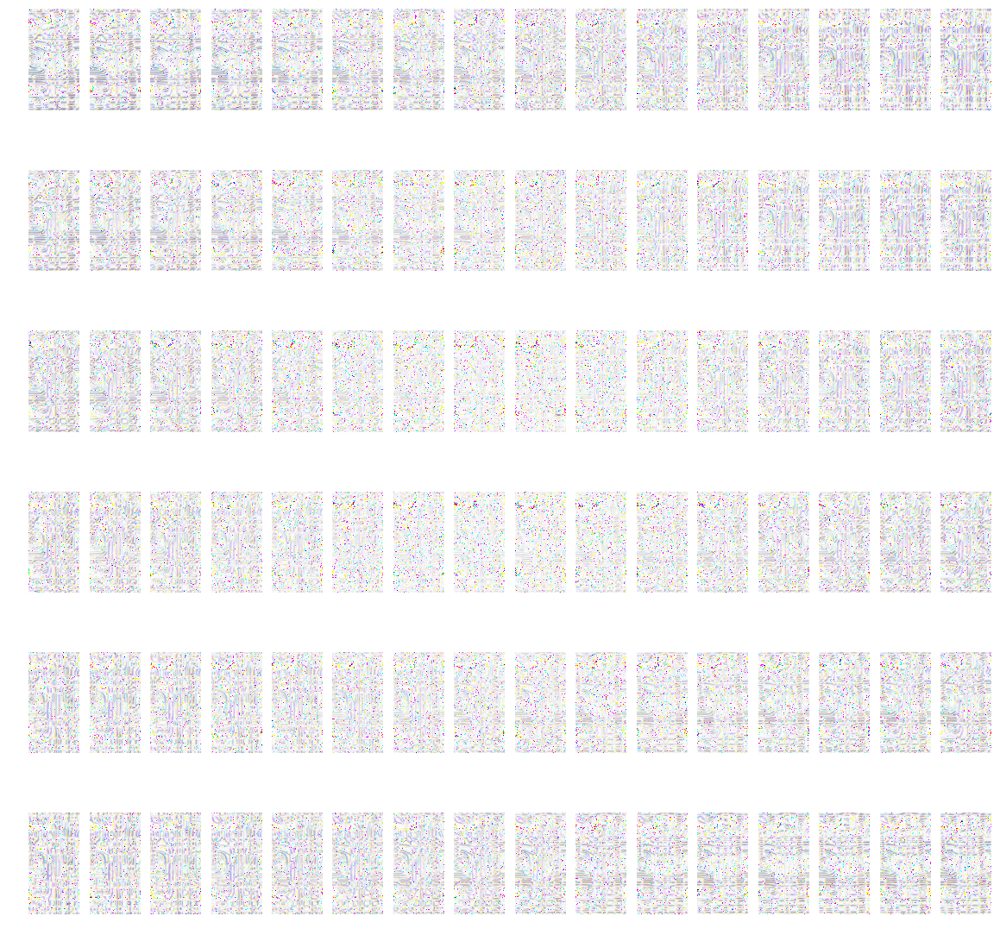

In [220]:
# visualize
# idx = np.random.randint(len(anns))
a = anns.values()[idx]
is_err = a['is_err_offset']
slcCompAvg = a['slcCompAvg_offset']
fig, ax = plt.subplots(slcNumY, slcNumX, figsize=(20,20))
for i in range(slcNumY):
    for j in range(slcNumX):
#         if is_err[i][j] == 0 :
#             try :
        ax[i,j].imshow(np.rint(slcCompAvg[i][j]), vmin=0, vmax=255, cmap='gray')
#             except :
#                 print i, j, is_err
#         else :
#             slcCompAvg[i][j] = -1
        ax[i,j].axis('off')
        
# plt.savefig('compareGrayAvg_resize.png')
# print np.max(abs(currImg - baseImg))/255

In [217]:
# subtract by 4 near slice
# compSlcs = []
# horIter = len(horIdx)-1
# verIter = len(verIdx)-1
# fig, ax = plt.subplots(verIter-2, horIter-2, figsize=(7,10))
for a in anns.values() :
    slcCompSub = [ [x for x in range(1, slcNumX-1)] for y in range(1, slcNumY-1) ]
    slc = a['slc_offset']
    is_err = a['is_err_offset']
    for i in range(1, slcNumY-1):
        for j in range(1, slcNumX-1):
#             if is_err[i][j] == 0 :
            baseSlc = 0
            cnt = 0
            if is_err[i-1][j] == 0 :
                baseSlc += slc[i-1][j]
                cnt += 1
            if is_err[i+1][j] == 0 :
                baseSlc += slc[i+1][j]
                cnt += 1
            if is_err[i][j-1] == 0 :
                baseSlc += slc[i][j-1]
                cnt += 1
            if is_err[i][j+1] == 0 :
                baseSlc += slc[i][j+1]
                cnt += 1
#             baseSlc = (slc[i-1][j] + slc[i+1][j] + slc[i][j-1] + slc[i][j+1])/4
            baseSlc = baseSlc/cnt
            slcCompSub[i-1][j-1] = abs(slc[i][j] - baseSlc)
#             print np.average(slcCompSub[i-1][j-1])
#             else :
#                 slcCompSub[i-1][j-1] = np.zeros((resizeY, resizeX))
                
    a['slcCompSub_offset'] = slcCompSub
# plt.savefig('compareGrayAround_resize.png')
# print np.max(abs(currImg - baseImg))/255

6.18488520408
6.27190263605
6.25632440476
6.43349277211
6.44558886054
6.59944515306
6.81215348639
6.69609268707
6.86814413265
6.93640518707
6.91676445578
7.15507653061
7.08643282313
7.08357780612
6.34590561224
6.48540816327
6.62875637755
6.33211522109
6.61668579932
6.72878188776
7.07250637755
6.81761904762
6.88465348639
7.07731717687
7.05555484694
7.12936862245
7.15305909864
7.02394557823
6.37234693878
6.66980442177
6.73048469388
6.58001488095
6.63053146259
6.91919430272
8.98348922902
8.8016468254
6.98928358844
6.99039540816
6.98369260204
7.13683248299
6.93124787415
6.94794430272
6.44121173469
6.56475977891
6.69889030612
6.65890518707
6.98193452381
8.69323412698
11.5463265306
13.6339455782
8.76403628118
7.15516581633
7.02141581633
7.206875
6.8662457483
6.85827380952
6.87460884354
6.6634204932
6.84666028912
6.91140306122
6.96392006803
7.09853528912
7.11613307823
9.00352324263
7.23175170068
7.50474914966
7.4281079932
7.52147534014
7.51142219388
7.46450892857
6.95744260204
6.93526573129
7

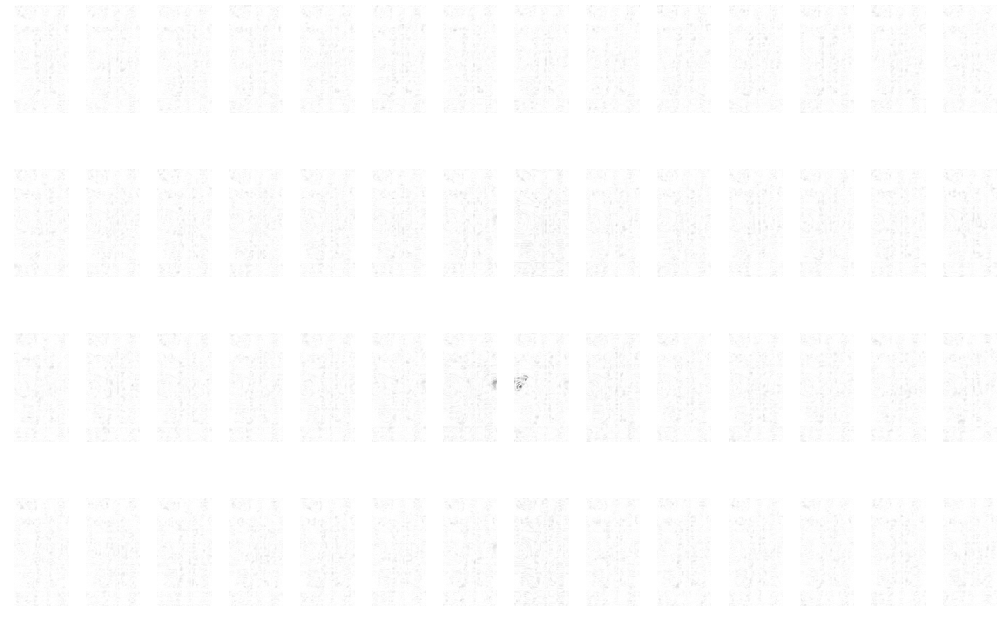

In [228]:
# visualize
idx = np.random.randint(len(anns))
a = anns.values()[idx]
is_err = a['is_err_offset']
slcCompSub = a['slcCompSub_offset']
fig, ax = plt.subplots(slcNumY-2, slcNumX-2, figsize=(30,20))
for i in range(1, slcNumY-1):
    for j in range(1, slcNumX-1):
#         if is_err[i][j] == 0 :
#             try :
        ax[i-1,j-1].imshow(rgb2gray(np.rint(slcCompSub[i-1][j-1])), vmin=0, vmax=255, cmap='gray_r')
#             except :
#                 print i, j, is_err
#         else :
#             slcCompAvg[i][j] = -1
        ax[i-1,j-1].axis('off')
plt.tight_layout()
# plt.savefig('compareGrayAvg_resize.png')
# print np.max(abs(currImg - baseImg))/255

# Analyze

9.12954455676
7.82370498169
4.81923071116
5.5110527164


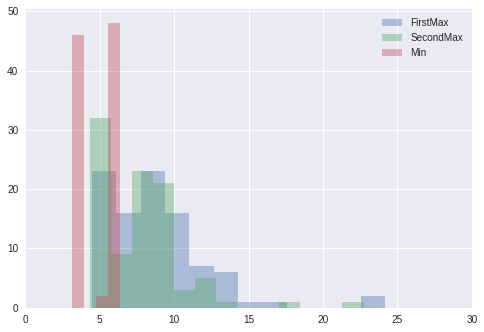

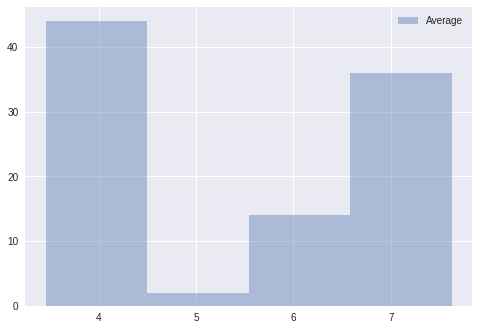

In [22]:
# 이미지별 슬라이스 평균 오차 최대최소 & 대표값
import seaborn as sns
sns.set(color_codes=True)
# slcComp = []
maxErrs = np.zeros((len(anns),1))
secErrs = np.zeros((len(anns),1))
minErrs = np.zeros((len(anns),1))
meanErrs = np.zeros((len(anns),1))
for i, a in enumerate(anns.values()) :
    mean = np.average(rgb2gray(abs(np.array(a['slcCompSub_offset']))), axis=(2,3))
    maxErrs[i] = np.max(mean)
    secErrs[i] = np.partition(mean.ravel(), -2)[-2]
    mean[mean==0] = np.average(mean[mean>0])
    minErrs[i] = np.min(mean)
    meanErrs[i] = np.average(mean[mean>0])
    
# errSlcs = np.average(abs(np.array(compSlcs)), axis=(2,3))
# print maxErrSlcs
# print secErrSlcs
plt.figure(1)
sns.distplot(maxErrs, kde=False, label="FirstMax")
sns.distplot(secErrs, kde=False, label="SecondMax")
# sns.distplot(minErrSlcs)
print np.average(maxErrs)
print np.average(secErrs)
# plt.figure(2)
sns.distplot(minErrs, kde=False, label="Min")
print np.average(minErrs)
plt.xlim([0, 30])
plt.legend()
plt.savefig("SliceAvgErr_MaxMin4.jpg")

plt.figure(2)
sns.distplot(meanErrs, kde=False, label="Average")
# plt.xlim([4.5, 8.5])
plt.legend()
print np.average(meanErrs)
# plt.savefig("SliceAvgErr_Avg4.jpg")

6.33896


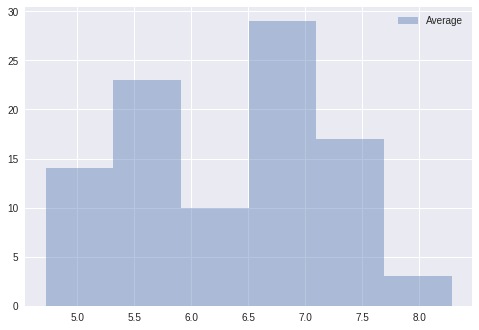

In [353]:
# # 이미지별 슬라이스 평균 오차 대표값
# import seaborn as sns
# sns.set(color_codes=True)
# errSlcs = np.average(abs(np.array(compSlcs)), axis=(2,3))
# avgErrSlcs = np.average(errSlcs, axis=1)
# sns.distplot(avgErrSlcs, kde=False, label="Average")
# plt.legend()
# # sns.distplot(secErrSlcs)
# # sns.distplot(minErrSlcs)
# print np.average(avgErrSlcs)
# plt.savefig("SliceAvgErr_Avg.jpg")

In [23]:
# Image Slice Position Statistics
fig1 = plt.figure(1)
for a in anns.values() :
    horIdx = a['slcX']
    print horIdx, a['img'].shape
#     plt.plot(horIdx, np.zeros_like(Idx), 'bo', ms=1)
fig2 = plt.figure(2)
for a in anns.values() :
    verIdx = a['slcY'], a['img'].shape
    print verIdx
#     plt.plot(verIdx, np.zeros_like(verIdx), 'bo', ms=1)

[0, 140, 280, 420, 560, 700, 840, 980, 1120, 1260, 1400, 1540, 1680, 1820, 1960, 2100, 2240] (2060, 2452, 3)
[0, 139, 278, 417, 556, 695, 834, 973, 1112, 1251, 1390, 1529, 1668, 1807, 1946, 2085, 2225] (2060, 2452, 3)
[0, 140, 280, 420, 560, 700, 840, 980, 1120, 1260, 1400, 1540, 1680, 1820, 1960, 2100, 2240] (2060, 2452, 3)
[0, 140, 280, 420, 560, 700, 840, 980, 1120, 1260, 1400, 1540, 1680, 1820, 1960, 2100, 2240] (2068, 2466, 3)
[0, 140, 279, 419, 558, 698, 837, 976, 1116, 1255, 1395, 1534, 1673, 1813, 1952, 2092, 2231] (2060, 2452, 3)
[0, 140, 280, 420, 560, 700, 840, 980, 1120, 1260, 1400, 1540, 1680, 1820, 1960, 2100, 2240] (2068, 2466, 3)
[0, 140, 279, 419, 558, 698, 837, 977, 1116, 1255, 1395, 1534, 1673, 1813, 1952, 2092, 2231] (2060, 2452, 3)
[0, 140, 279, 419, 558, 698, 837, 976, 1116, 1255, 1394, 1534, 1673, 1813, 1952, 2092, 2231] (2060, 2452, 3)
[0, 140, 280, 420, 560, 701, 840, 980, 1120, 1260, 1400, 1540, 1680, 1820, 1960, 2100, 2240] (2068, 2466, 3)
[0, 140, 280, 420, 

In [31]:
# 슬라이스 평균 분석
idx = np.random.randint(len(anns))
a = anns.values()[idx]
avgSlcs = np.average(a['slc'], axis=(2,3))
print idx
print avgSlcs[idx].reshape(vHgh,vWid)/np.max(avgSlcs[idx])
plt.imshow(avgSlcs[idx].reshape(vHgh,vWid)/np.max(avgSlcs[idx]), vmin=0, vmax=1, cmap='gray_r')

KeyError: 'slc'

44 0.871639
63 0.876559
19 0.872273
52 0.875193
45 0.923935
23 0.866638


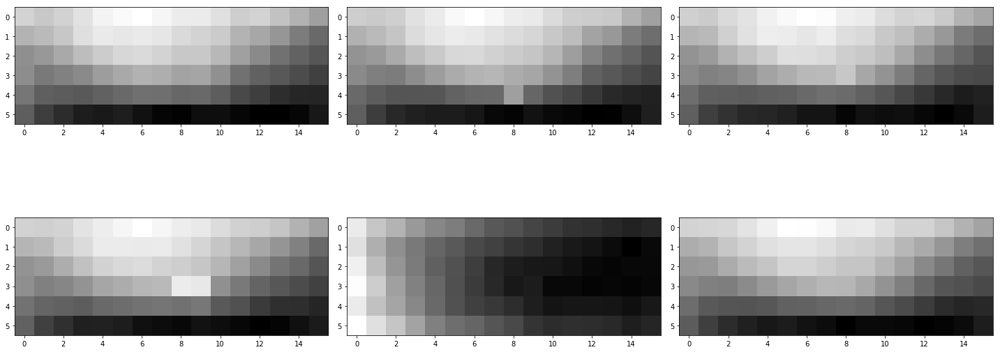

In [318]:
# 슬라이스 평균 분석
fig, ax = plt.subplots(2, 3, figsize=(20,10))
for i in range(2) :
    for j in range(3) :
        idx = np.random.randint(len(anns))
        a = anns.values()[idx]
        v = np.average(a['slc'], axis=(2,3))
        ax[i,j].imshow(v.reshape(slcNumY,slcNumX)/np.max(v), cmap='gray_r')
        print idx, np.min(v)/np.max(v)
#         ax[i,j].imshow(v.reshape(slcNumY,slcNumX)/np.max(avgSlcComp), cmap='gray_r', vmax=1, vmin=0)
plt.tight_layout()

18


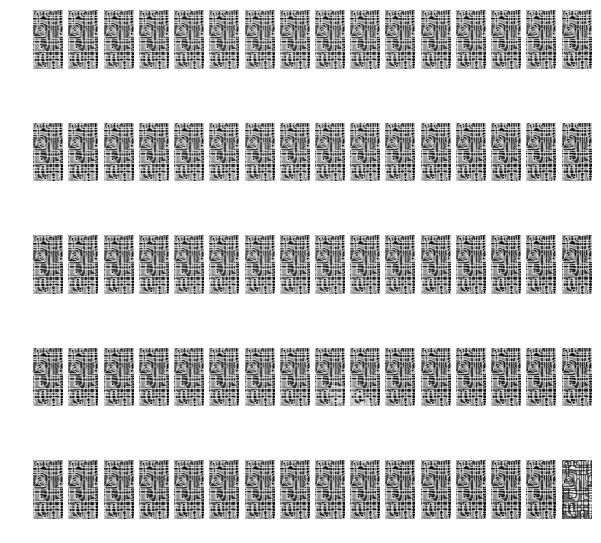

In [309]:
# visualize with 오류 분석 (average)
# idx = np.random.randint(len(corr))
print idx
fig, ax = plt.subplots(vHgh, vWid, figsize=(10,10))
for i in range(vHgh):
    for j in range(vWid):
        slcNum = i*vWid + j
        if slcNum != errIdx[idx]:
            ax[i,j].imshow(imgSlcs[idx][slcNum], vmin=0, vmax=255, cmap='gray_r')
        else:
            ax[i,j].imshow(imgSlcs[idx][slcNum], vmin=0, vmax=255, cmap='gray')
        ax[i,j].axis('off')

87


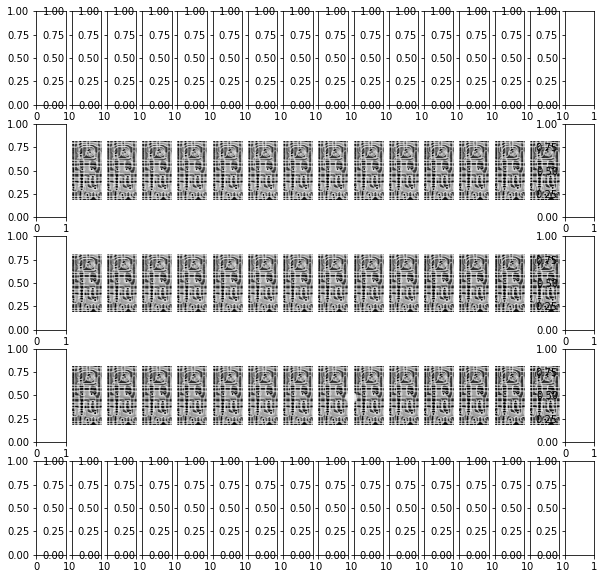

In [303]:
# visualize with 오류 분석 (4 near)
# idx = np.random.randint(len(corr))
print idx
horIdx, verIdx = idxsSlc[idx]
vWid = len(horIdx)-1
vHgh = len(verIdx)-1
fig, ax = plt.subplots(vHgh, vWid, figsize=(10,10))
for i in range(1, vHgh-1):
    for j in range(1, vWid-1):
        slcNum = i*vWid + j
        if slcNum != errIdx[idx]:
            ax[i,j].imshow(imgSlcs[idx][slcNum], vmin=0, vmax=255, cmap='gray_r')
        else:
            ax[i,j].imshow(imgSlcs[idx][slcNum], vmin=0, vmax=255, cmap='gray')
        ax[i,j].axis('off')

In [41]:
def visualize_with_key(n, m, x, y, key, anns) :
    fig, ax = plt.subplots(n, m, figsize=(10,10))
    for i in range(n) :
        for j in range(m) :
            idx = np.random.randint(len(anns))
            print i, j, idx
            a = anns.values()[idx]
            value = np.average(a[key], axis=(2,3))
            ax[i,j] = plt.imshow(value.reshape(y,x)/np.max(avgSlcComp), cmap='gray_r')

10
45
92
36
29
19


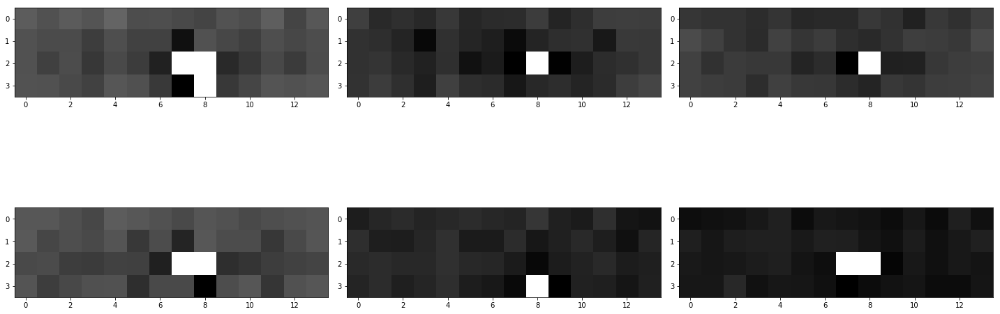

In [43]:
# visualize with mean of error slices

# visualize_with_key(2, 3, slcNumX-2, slcNumY-2, 'slcCompSub', anns)
fig, ax = plt.subplots(2, 3, figsize=(20,10))
for i in range(2) :
    for j in range(3) :
        idx = np.random.randint(len(anns))
        print idx
        a = anns.values()[idx]
        avgSlcComp = np.average(a['slcCompSub'], axis=(2,3))
        ax[i,j].imshow(avgSlcComp.reshape(slcNumY-2,slcNumX-2)/np.max(avgSlcComp), cmap='gray_r')
plt.tight_layout()

In [35]:
print mean

[[ 17.07304215  16.26781592  16.47582985  13.69521372  11.30958196
   12.0198929   13.0593624   11.13514213   9.58023485  12.00554849
   10.91609245  10.85211845  13.61590303  16.3806043   16.51929103
   16.97056527]
 [ 13.63710636  12.66246325  12.55819163   9.96628097   8.03493345
    7.94186995   9.09781743   7.54872554   6.80077352   9.26068627
    9.04099503   9.77623167  12.41501038  15.21135259  15.48660802
   16.34271854]
 [ 16.22567398  14.47331904  13.30130033  11.83316852  10.62272015
    9.10437596   8.02452747   6.77273101   6.00187534   6.23329605
    5.74232363   6.54305039   8.14239323  10.54643578  11.09089723
   12.19832304]
 [ 16.42376394  14.13090742  12.45252842  11.44305354  10.96753105
    8.70107157   7.06596004   6.75342871   7.29602688   0.           0.
    9.17103878   9.55753728  10.92760562  11.84713137  13.20962019]
 [ 17.44552947  14.89804189  12.83928247  12.45811746  12.74284879
   10.24489211   8.03774695   8.86287741  10.39910443   0.           0.
   

In [7]:
baseImg = np.average(np.array(imageCrop), axis=0).astype(float)
# baseImg = imageCrop[0].astype(int)
# fig, ax = plt.subplots(len(verIdx)-1, len(horIdx)-1, figsize=(7,10))
meanSqrErr = []
for i in range(len(verIdx)-1):
    for j in range(len(horIdx)-1):
#         if i==0 and j==0:
#             baseImg = (imageCrop[1*horIter+0] + imageCrop[0*horIter+0])/2
#         elif i==verIter and j==horIter:
#             baseImg = (imageCrop[(verIter-2)*horIter+(horIter-1)] + imageCrop[(verIter-1)*horIter+(horIter-2)])/2
#         elif i==0:
#         baseImg = imageCrop[(i-1)*horIter + (j-1)] + imageCrop[(i-1)*horIter + (j+1)] + imageCrop[(i+1)*horIter + (j-1)] + imageCrop[(i+1)*horIter + (j+1)]
#         baseImg = (baseImg/4)
        currImg = imageCrop[i*(len(horIdx)-1) + j].astype(float)
        meanSqrErr.append(np.mean(np.power((currImg-baseImg)/256, 2)))

print meanSqrErr
print math.sqrt(np.mean(meanSqrErr))*256
print math.sqrt(np.max(meanSqrErr))*256
print math.sqrt(meanSqrErr[55])*256
print np.argmax(meanSqrErr)

NameError: name 'imageCrop' is not defined

In [146]:
mean = []
for i in range(len(verIdx)-1):
    for j in range(len(horIdx)-1):
#         if i==0 and j==0:
#             baseImg = (imageCrop[1*horIter+0] + imageCrop[0*horIter+0])/2
#         elif i==verIter and j==horIter:
#             baseImg = (imageCrop[(verIter-2)*horIter+(horIter-1)] + imageCrop[(verIter-1)*horIter+(horIter-2)])/2
#         elif i==0:
#         baseImg = imageCrop[(i-1)*horIter + (j-1)] + imageCrop[(i-1)*horIter + (j+1)] + imageCrop[(i+1)*horIter + (j-1)] + imageCrop[(i+1)*horIter + (j+1)]
#         baseImg = (baseImg/4)
        currImg = imageCrop[i*(len(horIdx)-1) + j].astype(float)
        mean.append(np.mean(currImg))
        
print mean

[106.34229390681004, 106.84982078853047, 106.17629288274449, 105.59016897081413, 105.30780849974398, 103.93069636456734, 103.8195084485407, 104.21530977982592, 105.68494623655914, 104.74713261648745, 105.37780337941628, 107.91815156169994, 107.94833589349719, 106.9878648233487, 104.84641577060933, 105.83399897593446, 105.16712749615975, 105.08535586277522, 106.63952892985151, 105.15199692780338, 104.92862263184844, 106.27923707117256, 109.68026113671274, 109.78737839221711, 108.91594982078853, 107.14180747567845, 106.21349206349207, 106.77798259088581, 105.81810035842294, 106.04267793138762, 105.47240143369176, 105.24441884280594, 106.57506400409626, 110.07027649769586, 111.35645161290323, 110.56190476190476, 110.42923707117255, 109.58371735791091, 108.24403481822837, 107.41374807987711, 106.86763952892986, 110.51047107014848, 107.9916026625704, 108.17598566308244, 111.75043522785458, 112.22306707629288, 112.19920634920635, 113.33397337429595, 112.80665642601126, 111.78691756272401, 11

# ETC

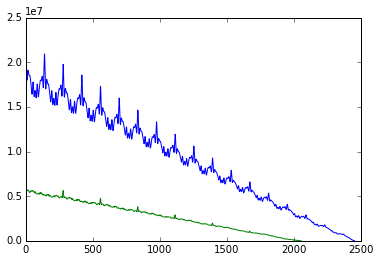

In [8]:
horCorr = autocorr(gray[0,:])
verCorr = autocorr(gray[:,0])
# print test.shape
plt.plot(horCorr)
plt.plot(verCorr)
plt.show()

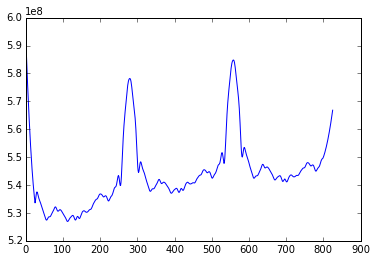

In [72]:
horCorrSmth = scipy.signal.savgol_filter(horCorr, 51, 2)
verCorrSmth = scipy.signal.savgol_filter(verCorr, 51, 2)
# plt.plot(horCorrSmth)
plt.plot(verCorrSmth)

[ 137  277  416  555  694  833  972 1111 1250 1389 1523 1662 1800 1939 2078]
[ 2026.81419579  2008.86268497  1991.21671745  1973.87629324  1956.84141235
  1940.11207476  1923.68828049  1907.57002952  1891.75732187  1876.25015753
  1861.04853649  1846.15245877  1828.72802468  1820.41868446  1811.69401855]


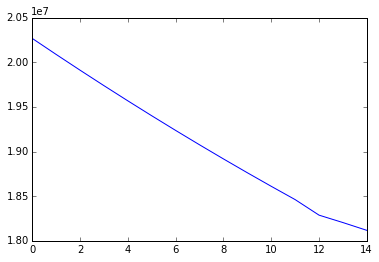

In [203]:
localMax = argrelextrema(horCorrSmth, np.greater)
localMaxMax = argrelextrema(horCorrSmth[localMax], np.greater)
print localMax[0][localMaxMax]
print horCorrSmth[localMaxMax]/10000
plt.plot(horCorrSmth[localMaxMax])
horSplt = localMax[0][localMaxMax]

In [ ]:
localMax = argrelextrema(verCorrSmth, np.greater)
localMaxMax = argrelextrema(verCorrSmth[localMax], np.greater)
print localMax[0][localMaxMax]
print horCorrSmth[localMaxMax]/10000
plt.plot(horCorrSmth[localMaxMax])
horSplt = localMax[0][localMaxMax]

In [56]:
localMaxArr = np.array(localMax)
print localMaxArr.shape
print localMaxArr[:,[22,45,68]]
print test[localMaxArr[:,[22,45,68]]]/10000

(1L, 169L)
[[279 559 838]]
[[ 1.09566619  0.91201617  0.71852766]]


In [50]:
localMaxArr = np.array(localMax)
print localMaxArr.shape
print localMaxArr[:,[7,16,26,36]]

(1L, 169L)
[[140 280 419 559]]


In [153]:
verIter = gray.shape[0]/verIntv
horIter = gray.shape[1]/horIntv
imageCrop = []
for i in range(verIter):
    for j in range(horIter):
        imageCrop.append(image[i*verIntv:(i+1)*verIntv, j*horIntv:(j+1)*horIntv, :])

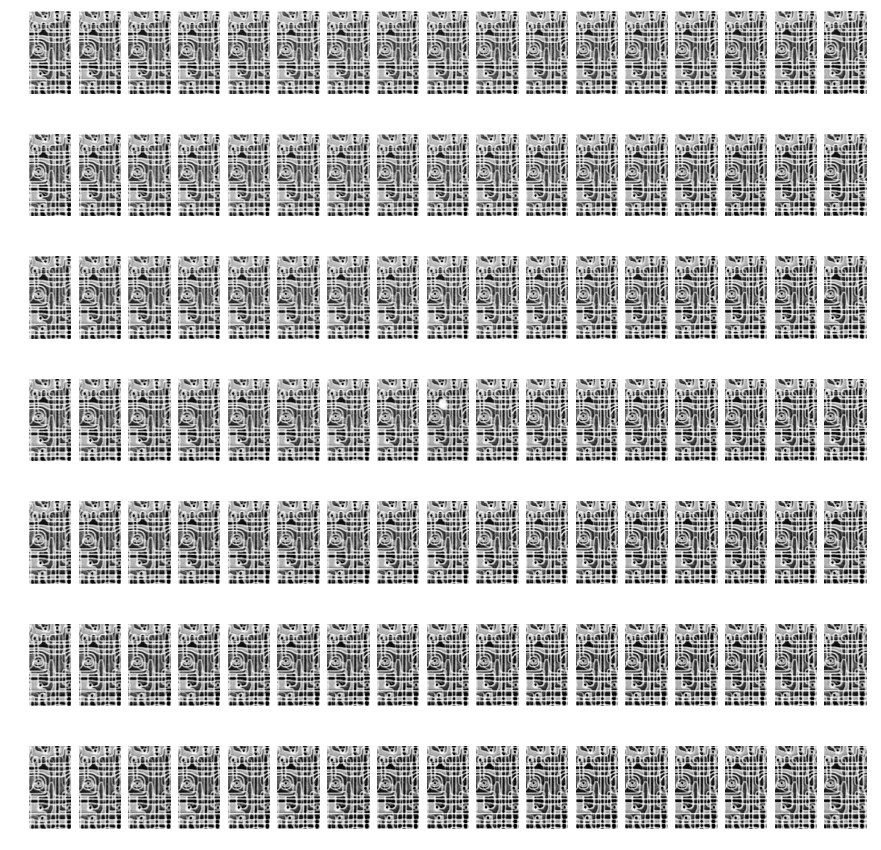

In [155]:
fig, ax = plt.subplots(verIter, horIter, figsize=(15,15))
# fig.axes.get_xaxis().set_visible(False)
for i in range(verIter):
    for j in range(horIter):
        ax[i,j].imshow(rgb2gray(imageCrop[i*horIter+j]), cmap='gray_r')
        ax[i,j].axis('off')
#         fig.add_subplot(verIter, horIter, i*horIter+j)
#         plt.imshow(imageCrop[i*horIter+j])
plt.savefig('gray.png')

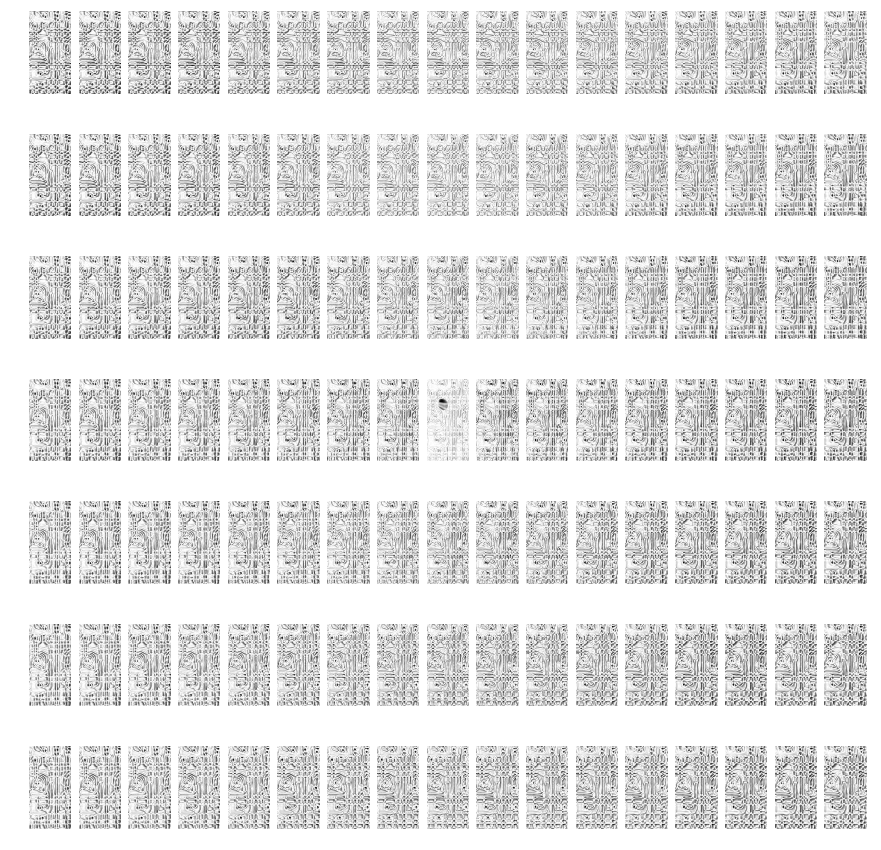

In [160]:
baseImg = np.average(np.array(imageCrop), axis=0).astype(int)
fig, ax = plt.subplots(verIter, horIter, figsize=(15,15))
for i in range(0, verIter):
    for j in range(0, horIter):
#         if i==0 and j==0:
#             baseImg = (imageCrop[1*horIter+0] + imageCrop[0*horIter+0])/2
#         elif i==verIter and j==horIter:
#             baseImg = (imageCrop[(verIter-2)*horIter+(horIter-1)] + imageCrop[(verIter-1)*horIter+(horIter-2)])/2
#         elif i==0:
#         baseImg = imageCrop[(i-1)*horIter + (j-1)] + imageCrop[(i-1)*horIter + (j+1)] + imageCrop[(i+1)*horIter + (j-1)] + imageCrop[(i+1)*horIter + (j+1)]
#         baseImg = (baseImg/4)
        ax[i,j].imshow(abs(rgb2gray(imageCrop[i*horIter + j]).astype(int) - rgb2gray(baseImg).astype(int)), cmap='gray_r')
        ax[i,j].axis('off')
plt.savefig('compareGrayAround.png')

In [ ]:
baseImg = imageCrop
fig, ax = plt.subplots(verIter, horIter, figsize=(15,15))
for i in range(verIter):
    for j in range(horIter):
        ax[i,j].imshow(abs(rgb2gray(imageCrop[i*horIter+j]).astype(int) - rgb2gray(baseImg).astype(int)), cmap='gray_r')
        ax[i,j].axis('off')
plt.savefig('compareGray.png')